In [1]:
import keras
from keras.models import Sequential
from keras.layers import Dense, Reshape, TimeDistributed, Flatten
from keras.layers import LSTM
from keras.layers.convolutional import Conv3D
from keras.layers.convolutional_recurrent import ConvLSTM2D
from keras.layers.normalization import BatchNormalization
import numpy as np
import pylab as plt
from keras_contrib.losses import DSSIMObjective
import os
import cv2

Using TensorFlow backend.
/home/mvoodarla/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/mvoodarla/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/mvoodarla/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/mvoodarla/.local/lib/python3.6/site-packages/tenso

In [2]:
from keras import backend as K
K.tensorflow_backend._get_available_gpus()

['/job:localhost/replica:0/task:0/device:GPU:0',
 '/job:localhost/replica:0/task:0/device:GPU:1']

In [3]:
path = 'caltech-pedestrian-dataset-converter/data/images/'
sets = ['set00_V001', 'set00_V002', 'set00_V003', 'set00_V004', 'set00_V005', 'set00_V006', 'set00_V007', 'set00_V008']
data = []
for seq in sets:
    count = 0
    sample = []
    while True:
        if os.path.isfile(path+seq+'_'+str(count)+'.png'):
            im = cv2.imread(path+seq+'_'+str(count)+'.png')
            small = cv2.resize(im, (0,0), fx=0.33, fy=0.33)
            sample.append(small)
            if len(sample) == 11:
                data.append(sample)
                sample = []
            count = count + 1
        else:
            print('breaking:',path+seq+'_'+str(count))
            break
data = np.array(data)

breaking: caltech-pedestrian-dataset-converter/data/images/set00_V001_1844
breaking: caltech-pedestrian-dataset-converter/data/images/set00_V002_1322
breaking: caltech-pedestrian-dataset-converter/data/images/set00_V003_568
breaking: caltech-pedestrian-dataset-converter/data/images/set00_V004_2133
breaking: caltech-pedestrian-dataset-converter/data/images/set00_V005_2133
breaking: caltech-pedestrian-dataset-converter/data/images/set00_V006_1930
breaking: caltech-pedestrian-dataset-converter/data/images/set00_V007_1929
breaking: caltech-pedestrian-dataset-converter/data/images/set00_V008_1703


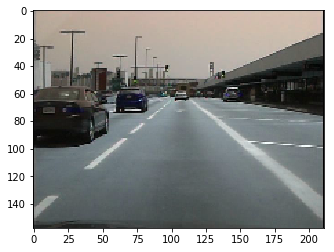

In [4]:
np.random.shuffle(data)
data.shape
data = data / 255.0
plt.imshow(data[0][10])

In [5]:
data.shape
input_sequence_frames = data[:, :10, :, :]
output_frames = data[:, 10:11, :, :]
output_frames = np.squeeze(output_frames, axis=1)


# plt.show()

In [6]:
input_sequence_frames.shape
output_frames.shape

(1228, 158, 211, 3)

In [7]:
#Define filters
filters = 10

model3 = Sequential()
model3.add(ConvLSTM2D(filters=filters, kernel_size=(3, 3),
                   input_shape=(10, 158, 211, 3),
                   padding='same', return_sequences=True))
model3.add(BatchNormalization())

model3.add(ConvLSTM2D(filters=filters, kernel_size=(3, 3),
                   padding='same', return_sequences=True))
model3.add(BatchNormalization())

model3.add(ConvLSTM2D(filters=filters, kernel_size=(3, 3),
                   padding='same', return_sequences=True))
model3.add(BatchNormalization())

model3.add(ConvLSTM2D(filters=3, kernel_size=(3, 3),
                   padding='same', activation='sigmoid'))

#Output shape = (batch_size, 1, 64, 64, 1)
# model3.add(BatchNormalization())

# model3.add(Conv3D(filters=1, kernel_size=(3, 3, 3),
#                activation='sigmoid',
#                padding='same', data_format='channels_last'))
ssim = DSSIMObjective(kernel_size=3)
def loss_combined(y_true, y_pred):
    return keras.losses.mean_squared_error(y_true, y_pred) + (ssim.__call__(y_true, y_pred)/8)
model3.compile(loss='mse', optimizer='adam')
model3.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv_lst_m2d_1 (ConvLSTM2D)  (None, 10, 158, 211, 10)  4720      
_________________________________________________________________
batch_normalization_1 (Batch (None, 10, 158, 211, 10)  40        
_________________________________________________________________
conv_lst_m2d_2 (ConvLSTM2D)  (None, 10, 158, 211, 10)  7240      
_________________________________________________________________
batch_normalization_2 (Batch (None, 10, 158, 211, 10)  40        
_________________________________________________________________
conv_lst_m2d_3 (ConvLSTM2D)  (None, 10, 158, 211, 10)  7240      
_________________________________________________________________
batch_normalization_3 (Batch (None, 10, 158, 211, 10)  40        
_________________________________________________________________
conv_lst_m2d_4 (ConvLSTM2D)  (None, 158, 211, 3)      

Epoch: 1
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where

Epoch 1/1
1228/1228 [==============================] - 100s 82ms/step - loss: 0.0170


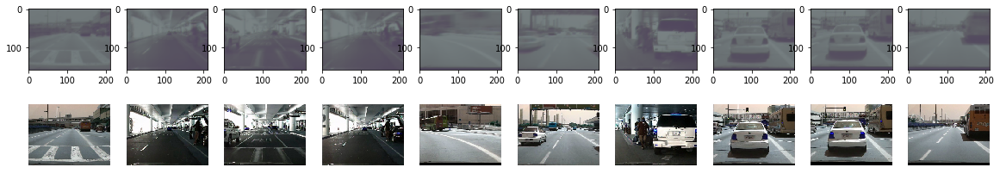

-----------------------------------
Epoch: 2
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0076


<Figure size 432x288 with 0 Axes>

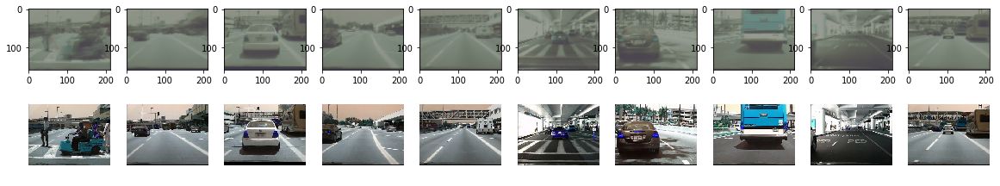

-----------------------------------
Epoch: 3
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0065


<Figure size 432x288 with 0 Axes>

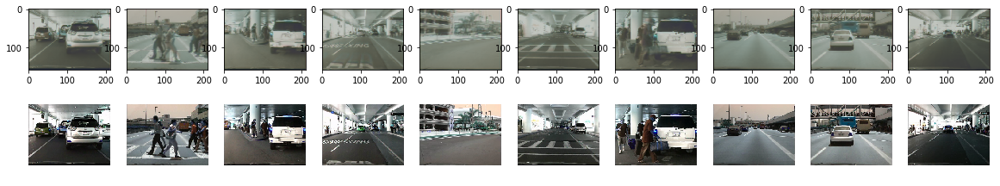

-----------------------------------
Epoch: 4
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0060


<Figure size 432x288 with 0 Axes>

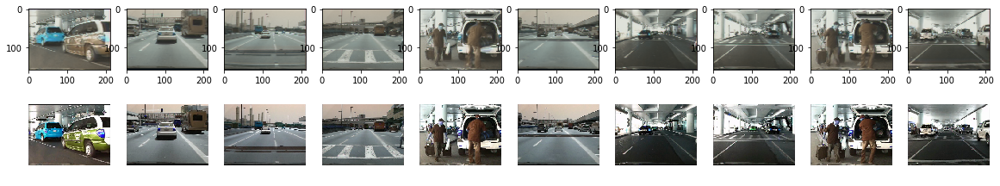

-----------------------------------
Epoch: 5
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0057


<Figure size 432x288 with 0 Axes>

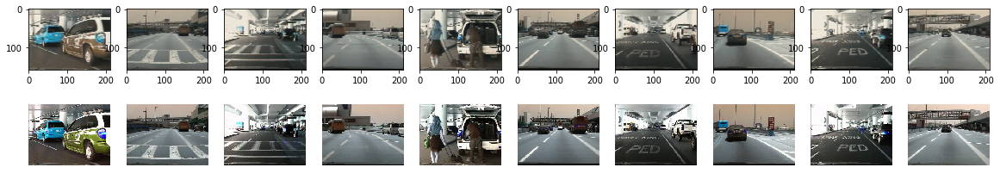

-----------------------------------
Epoch: 6
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0055


<Figure size 432x288 with 0 Axes>

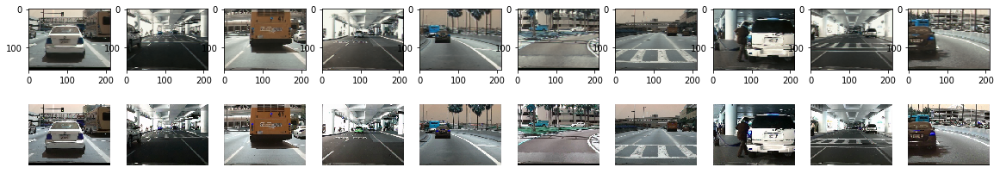

-----------------------------------
Epoch: 7
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0054


<Figure size 432x288 with 0 Axes>

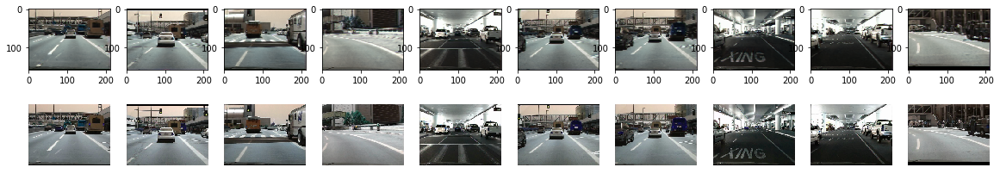

-----------------------------------
Epoch: 8
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0053


<Figure size 432x288 with 0 Axes>

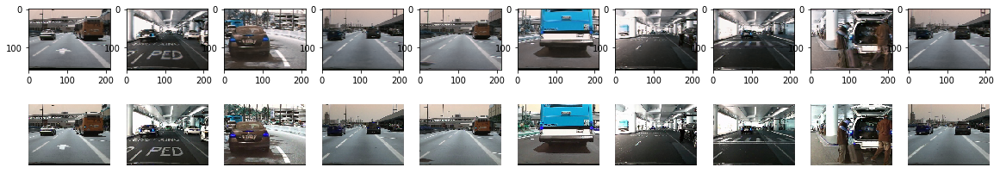

-----------------------------------
Epoch: 9
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0051


<Figure size 432x288 with 0 Axes>

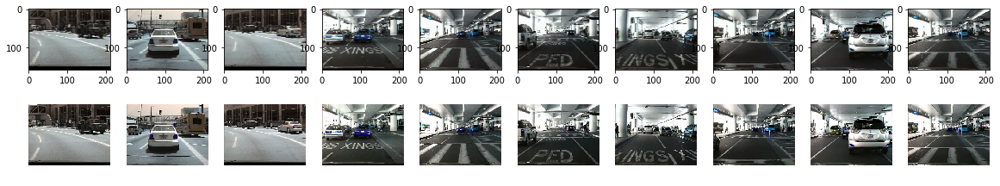

-----------------------------------
Epoch: 10
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0051


<Figure size 432x288 with 0 Axes>

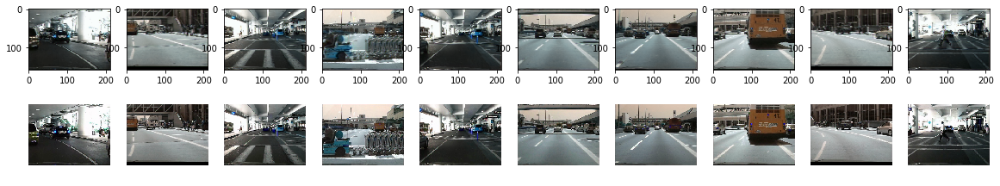

-----------------------------------
Epoch: 11
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0048


<Figure size 432x288 with 0 Axes>

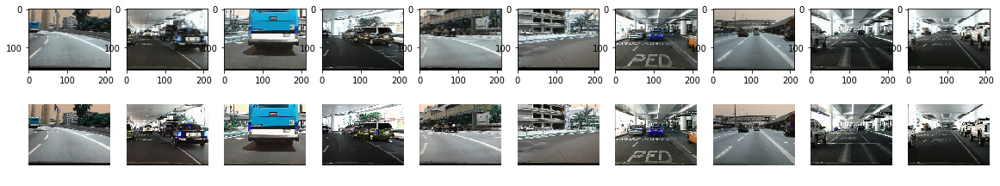

-----------------------------------
Epoch: 12
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0047


<Figure size 432x288 with 0 Axes>

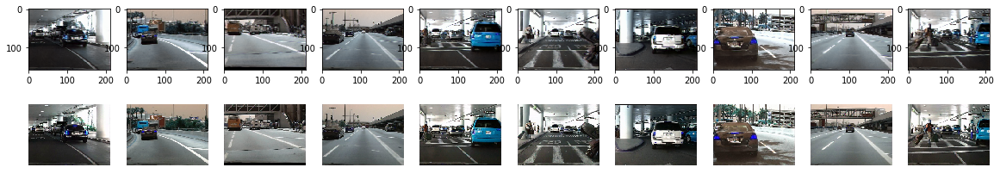

-----------------------------------
Epoch: 13
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0046


<Figure size 432x288 with 0 Axes>

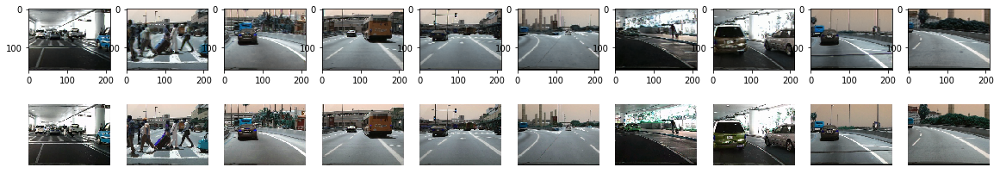

-----------------------------------
Epoch: 14
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0046


<Figure size 432x288 with 0 Axes>

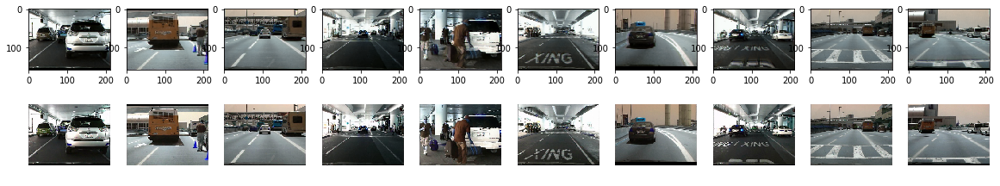

-----------------------------------
Epoch: 15
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0045


<Figure size 432x288 with 0 Axes>

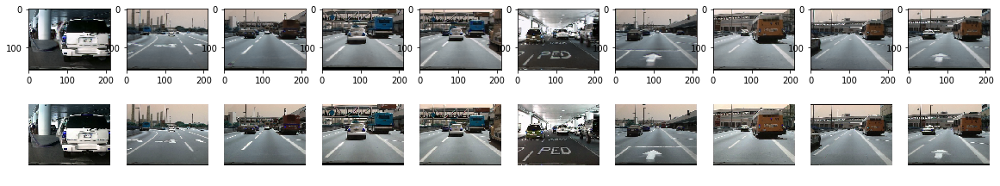

-----------------------------------
Epoch: 16
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0044


<Figure size 432x288 with 0 Axes>

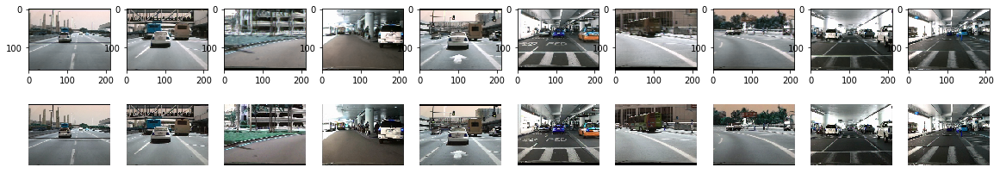

-----------------------------------
Epoch: 17
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0043


<Figure size 432x288 with 0 Axes>

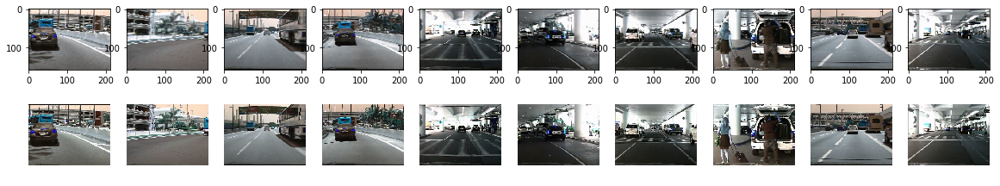

-----------------------------------
Epoch: 18
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0043


<Figure size 432x288 with 0 Axes>

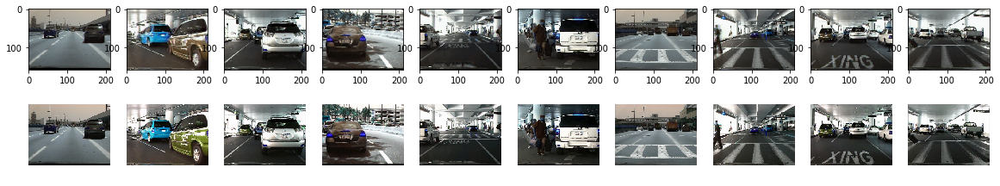

-----------------------------------
Epoch: 19
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0042


<Figure size 432x288 with 0 Axes>

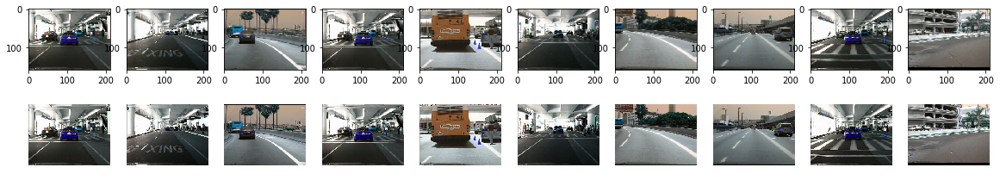

-----------------------------------
Epoch: 20
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0041


<Figure size 432x288 with 0 Axes>

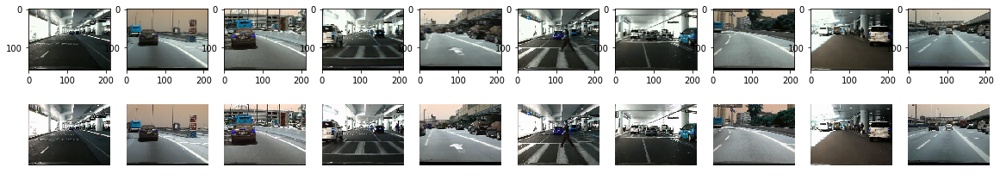

-----------------------------------
Epoch: 21
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0042


<Figure size 432x288 with 0 Axes>

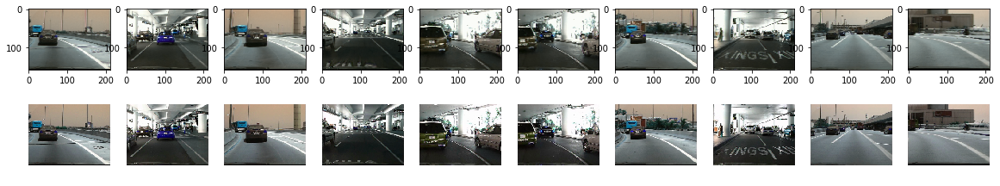

-----------------------------------
Epoch: 22
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0040


<Figure size 432x288 with 0 Axes>

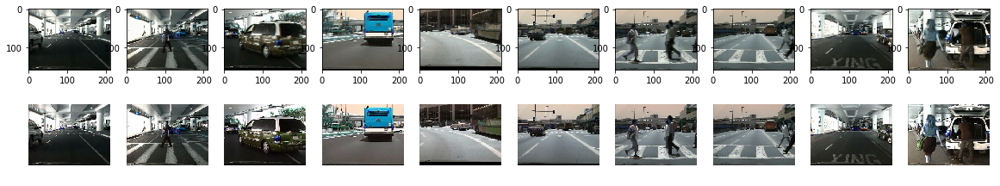

-----------------------------------
Epoch: 23
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0040


<Figure size 432x288 with 0 Axes>

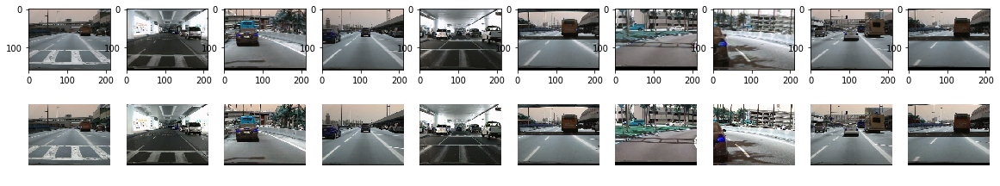

-----------------------------------
Epoch: 24
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0040


<Figure size 432x288 with 0 Axes>

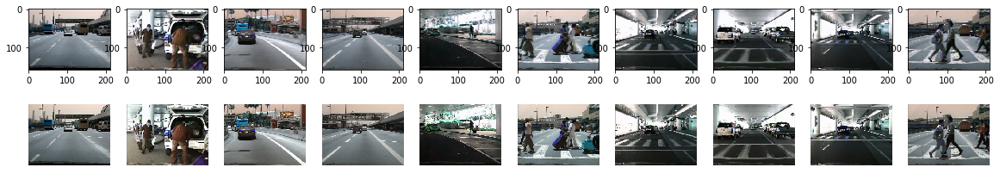

-----------------------------------
Epoch: 25
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0039


<Figure size 432x288 with 0 Axes>

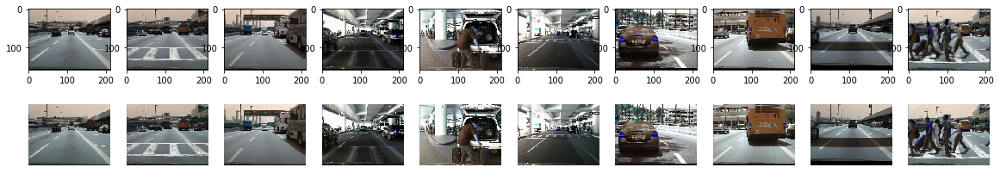

-----------------------------------
Epoch: 26
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0039


<Figure size 432x288 with 0 Axes>

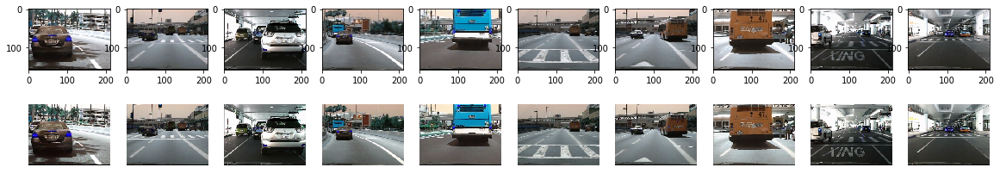

-----------------------------------
Epoch: 27
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0038


<Figure size 432x288 with 0 Axes>

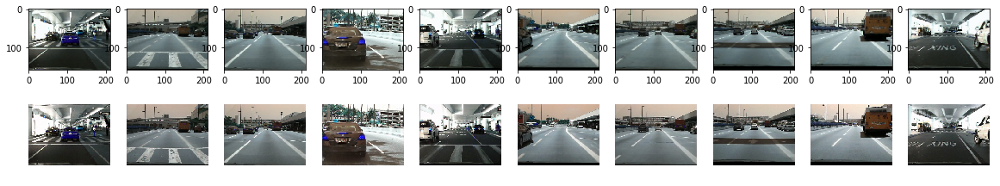

-----------------------------------
Epoch: 28
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0038


<Figure size 432x288 with 0 Axes>

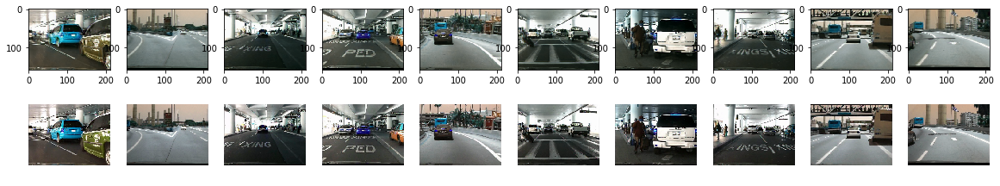

-----------------------------------
Epoch: 29
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0038


<Figure size 432x288 with 0 Axes>

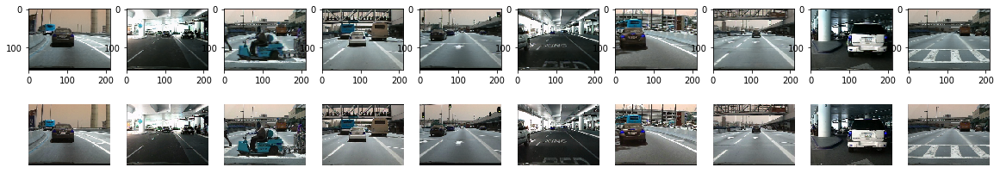

-----------------------------------
Epoch: 30
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0038


<Figure size 432x288 with 0 Axes>

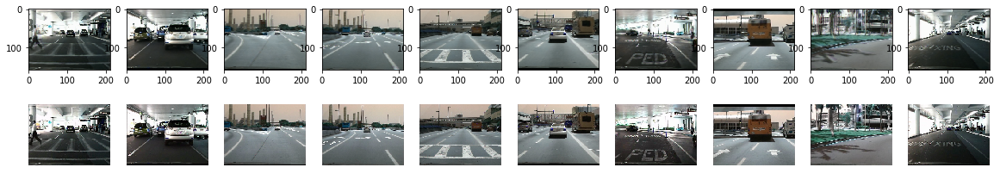

-----------------------------------
Epoch: 31
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0037


<Figure size 432x288 with 0 Axes>

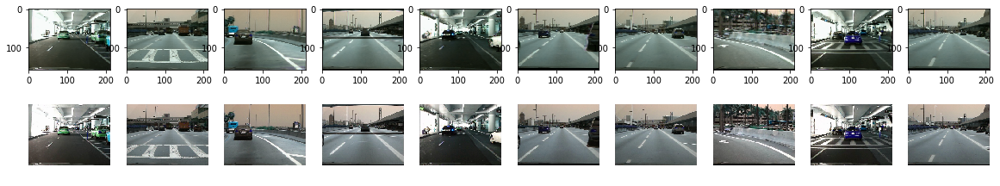

-----------------------------------
Epoch: 32
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0037


<Figure size 432x288 with 0 Axes>

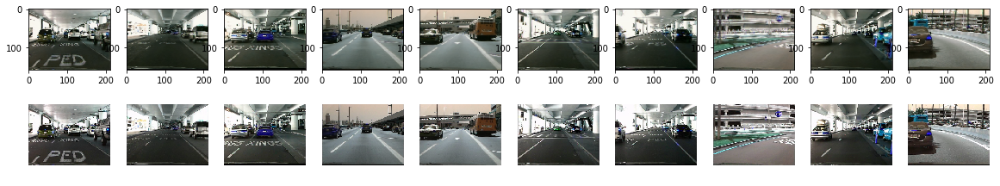

-----------------------------------
Epoch: 33
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0037


<Figure size 432x288 with 0 Axes>

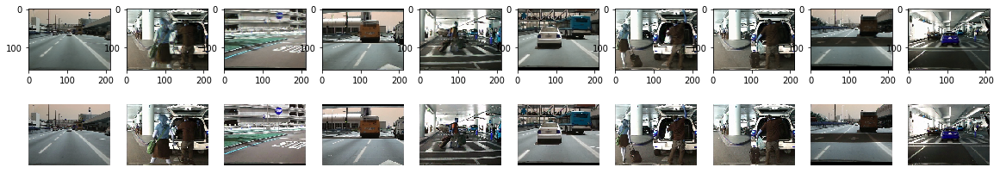

-----------------------------------
Epoch: 34
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0037


<Figure size 432x288 with 0 Axes>

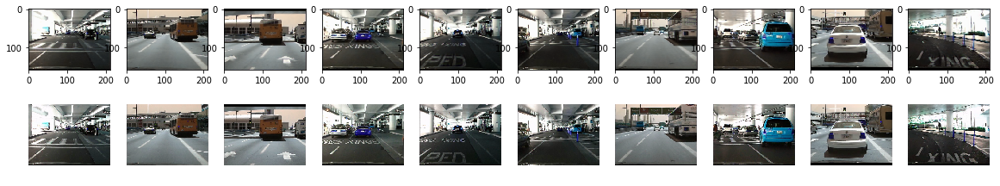

-----------------------------------
Epoch: 35
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0037


<Figure size 432x288 with 0 Axes>

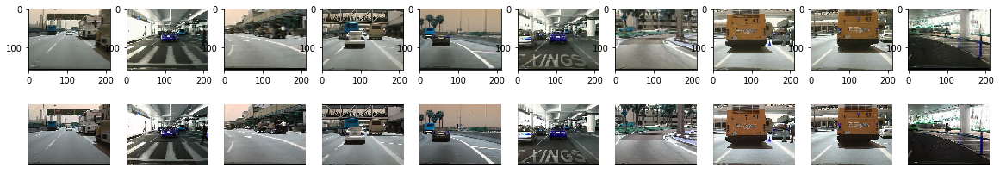

-----------------------------------
Epoch: 36
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0036


<Figure size 432x288 with 0 Axes>

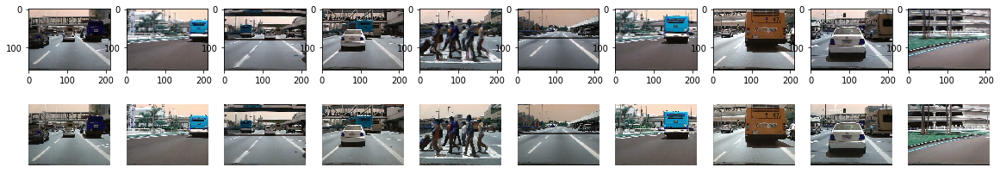

-----------------------------------
Epoch: 37
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0035


<Figure size 432x288 with 0 Axes>

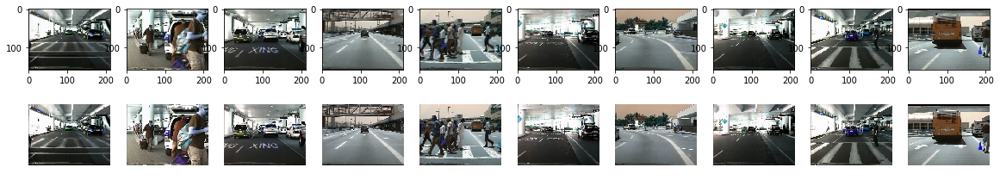

-----------------------------------
Epoch: 38
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0035


<Figure size 432x288 with 0 Axes>

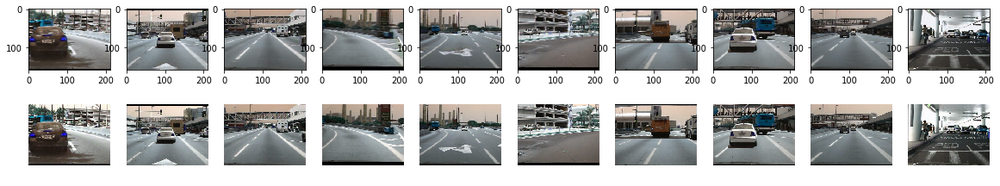

-----------------------------------
Epoch: 39
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0035


<Figure size 432x288 with 0 Axes>

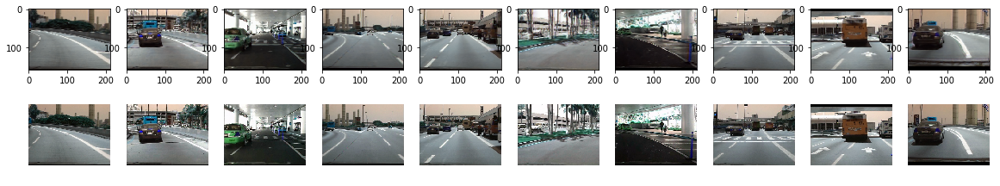

-----------------------------------
Epoch: 40
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0034


<Figure size 432x288 with 0 Axes>

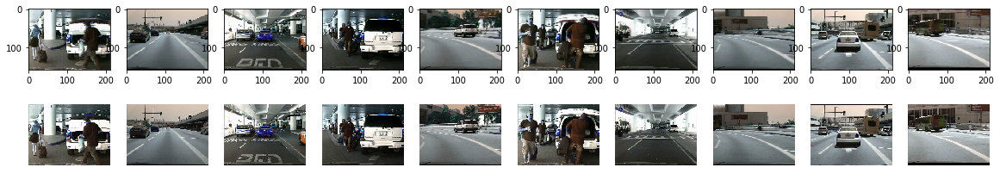

-----------------------------------
Epoch: 41
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0034


<Figure size 432x288 with 0 Axes>

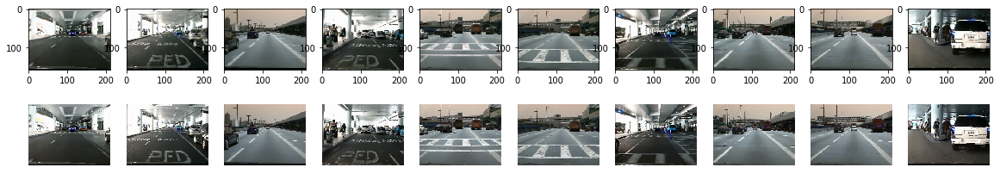

-----------------------------------
Epoch: 42
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0034


<Figure size 432x288 with 0 Axes>

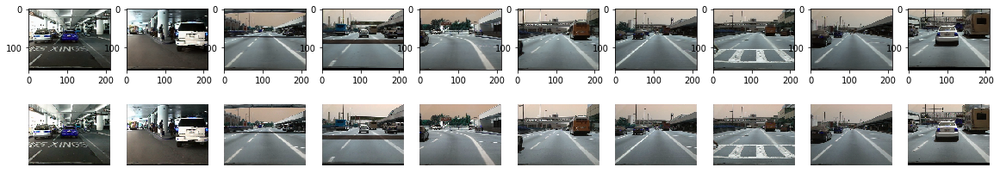

-----------------------------------
Epoch: 43
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0034


<Figure size 432x288 with 0 Axes>

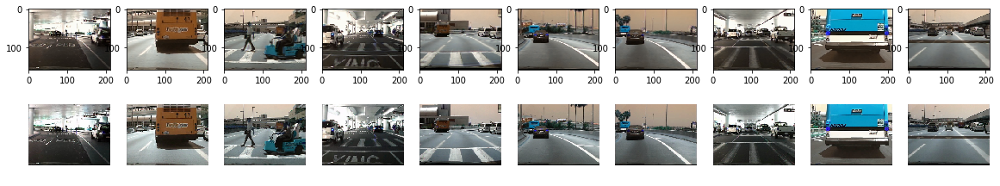

-----------------------------------
Epoch: 44
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0034


<Figure size 432x288 with 0 Axes>

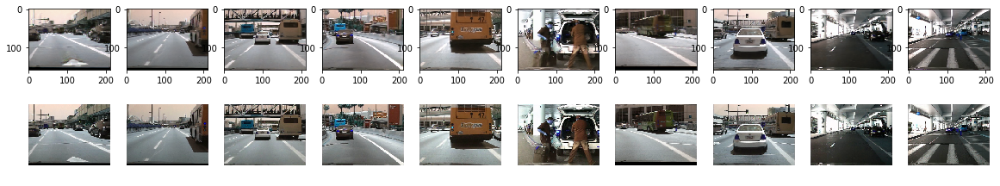

-----------------------------------
Epoch: 45
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0034


<Figure size 432x288 with 0 Axes>

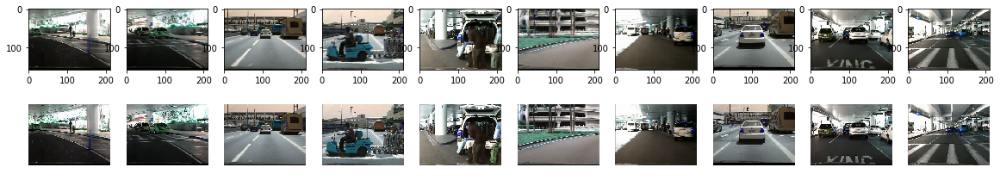

-----------------------------------
Epoch: 46
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0033


<Figure size 432x288 with 0 Axes>

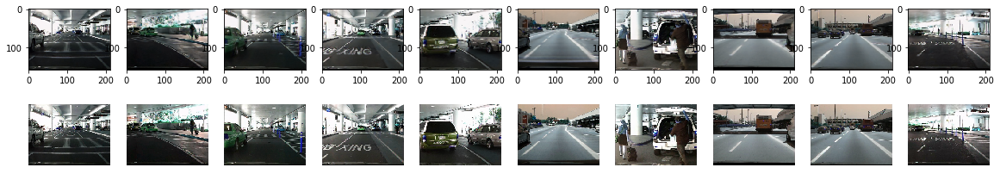

-----------------------------------
Epoch: 47
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0033


<Figure size 432x288 with 0 Axes>

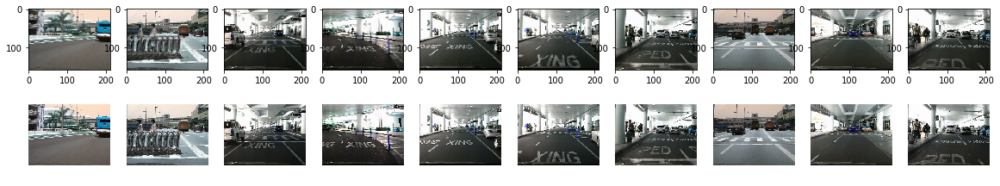

-----------------------------------
Epoch: 48
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0032


<Figure size 432x288 with 0 Axes>

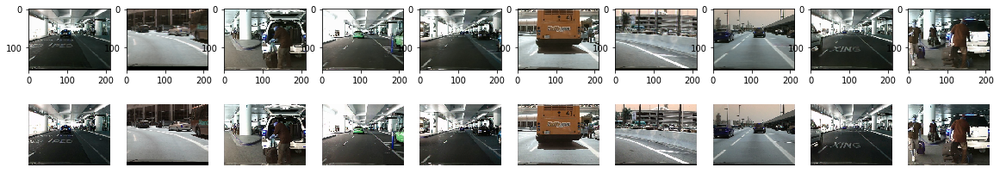

-----------------------------------
Epoch: 49
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0032


<Figure size 432x288 with 0 Axes>

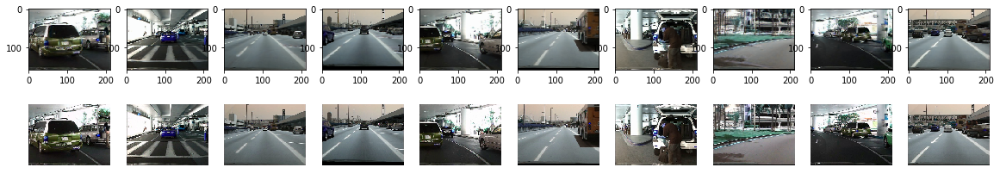

-----------------------------------
Epoch: 50
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0033


<Figure size 432x288 with 0 Axes>

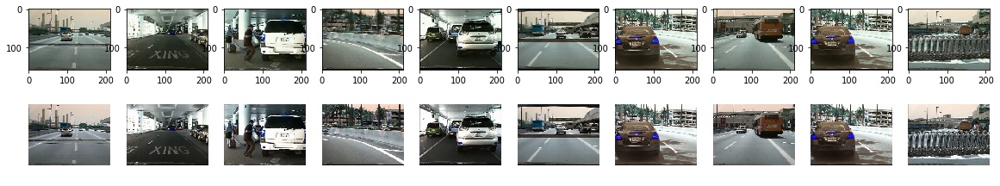

-----------------------------------
Epoch: 51
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0032


<Figure size 432x288 with 0 Axes>

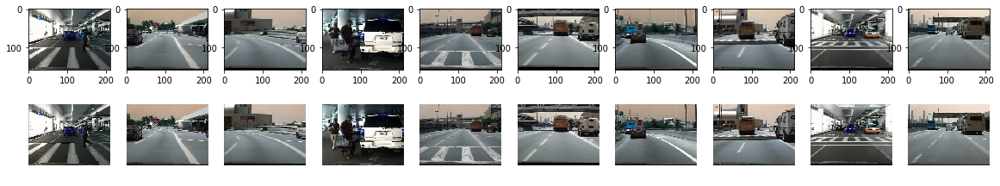

-----------------------------------
Epoch: 52
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0032


<Figure size 432x288 with 0 Axes>

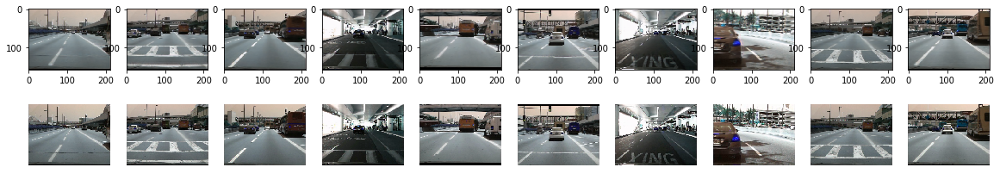

-----------------------------------
Epoch: 53
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0032


<Figure size 432x288 with 0 Axes>

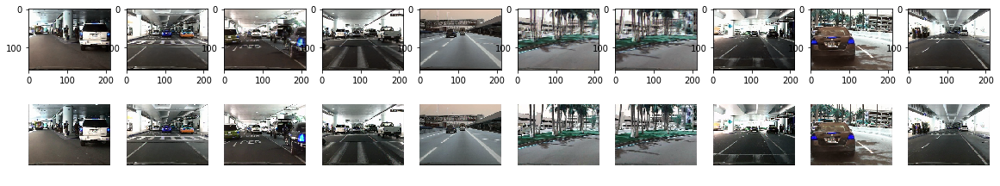

-----------------------------------
Epoch: 54
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0032


<Figure size 432x288 with 0 Axes>

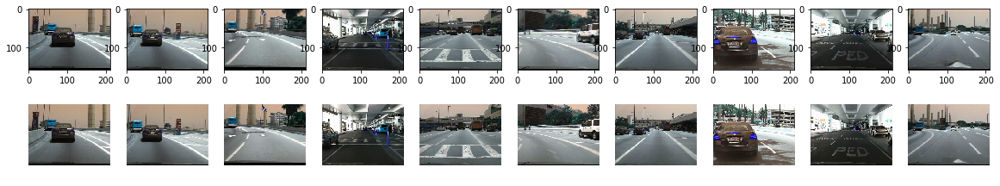

-----------------------------------
Epoch: 55
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0032


<Figure size 432x288 with 0 Axes>

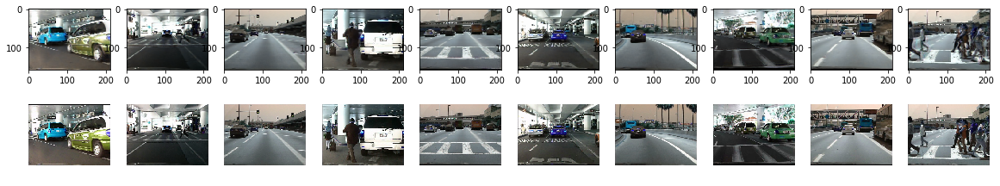

-----------------------------------
Epoch: 56
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

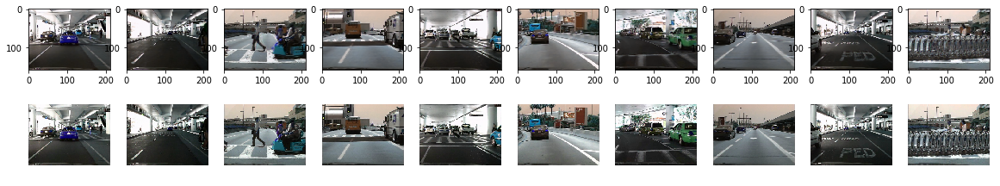

-----------------------------------
Epoch: 57
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

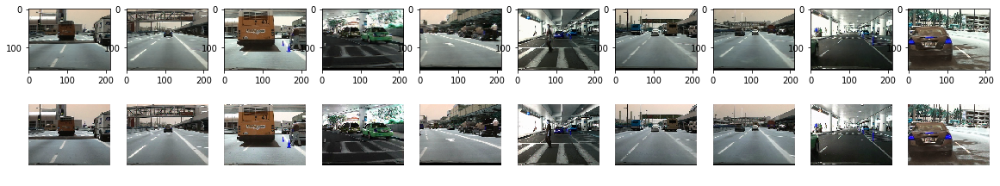

-----------------------------------
Epoch: 58
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

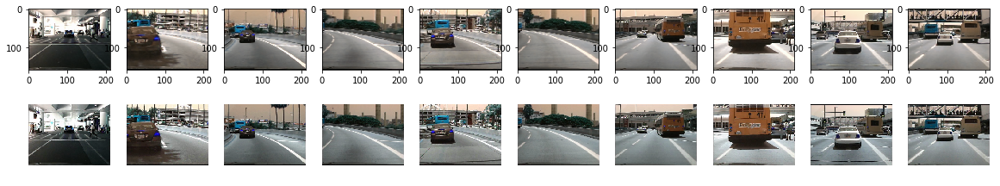

-----------------------------------
Epoch: 59
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0032


<Figure size 432x288 with 0 Axes>

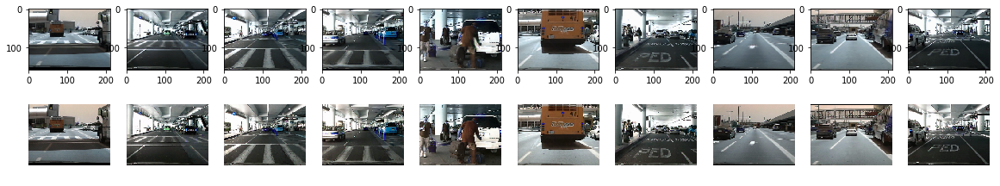

-----------------------------------
Epoch: 60
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

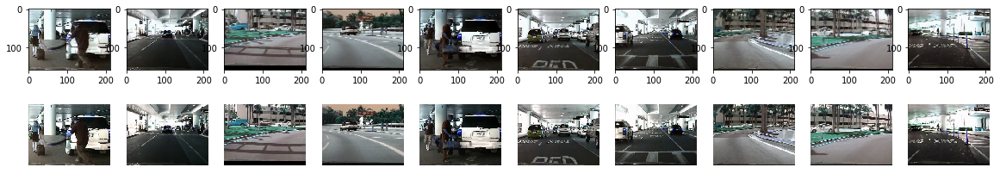

-----------------------------------
Epoch: 61
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

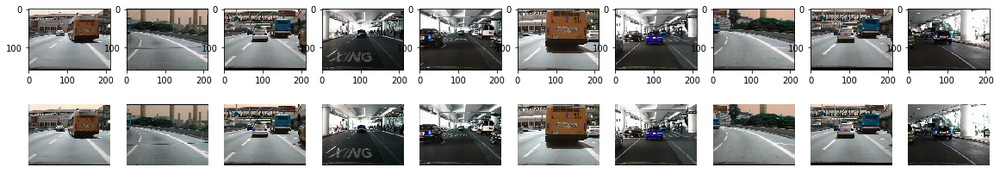

-----------------------------------
Epoch: 62
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

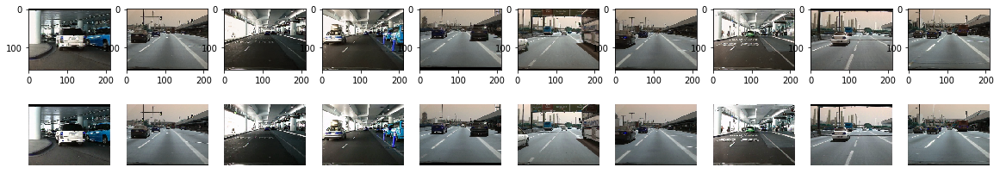

-----------------------------------
Epoch: 63
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

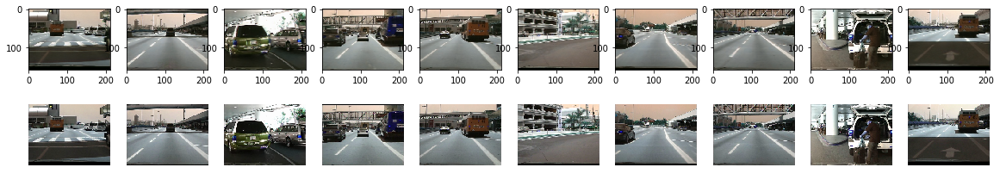

-----------------------------------
Epoch: 64
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

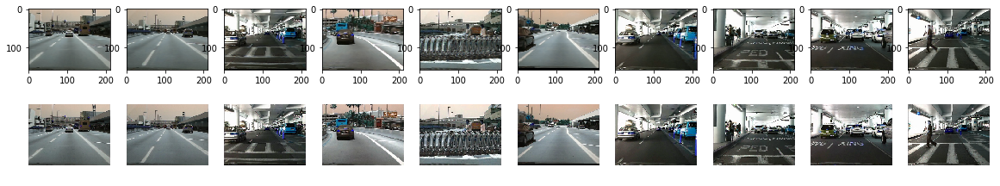

-----------------------------------
Epoch: 65
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

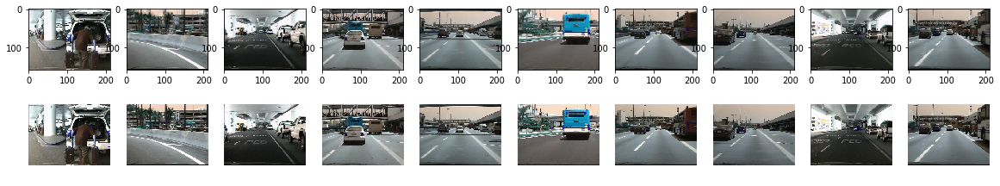

-----------------------------------
Epoch: 66
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

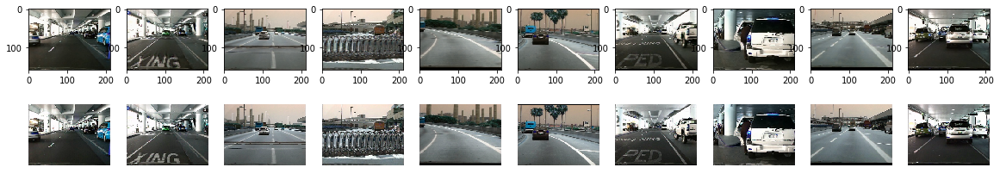

-----------------------------------
Epoch: 67
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

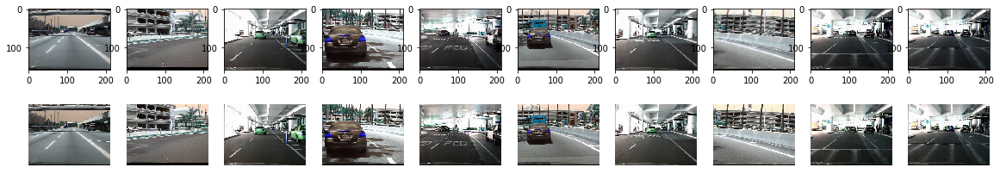

-----------------------------------
Epoch: 68
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

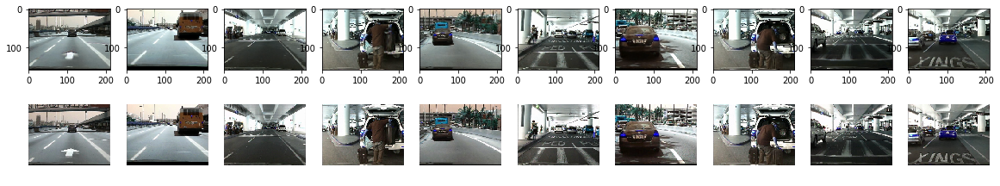

-----------------------------------
Epoch: 69
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0031


<Figure size 432x288 with 0 Axes>

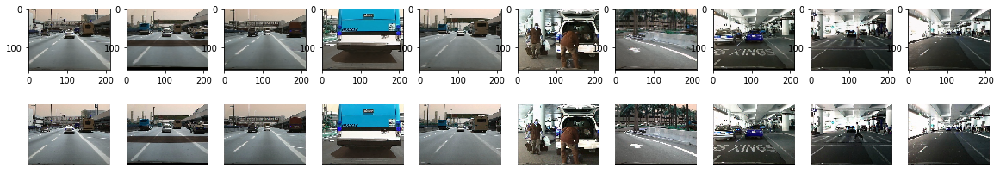

-----------------------------------
Epoch: 70
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

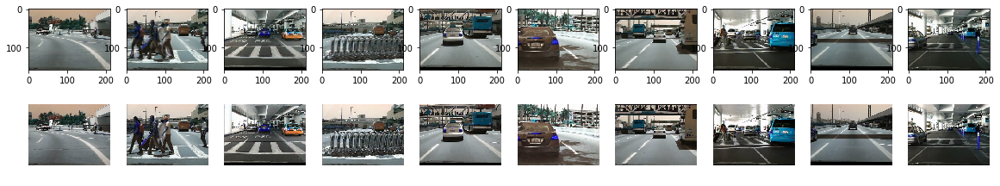

-----------------------------------
Epoch: 71
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

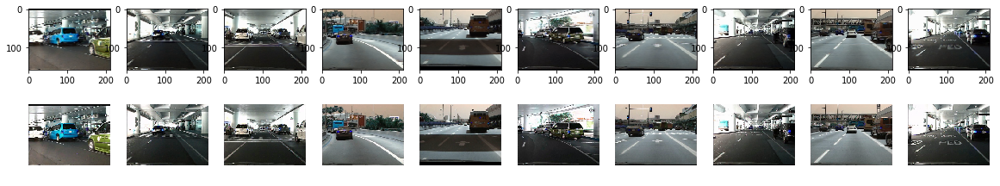

-----------------------------------
Epoch: 72
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

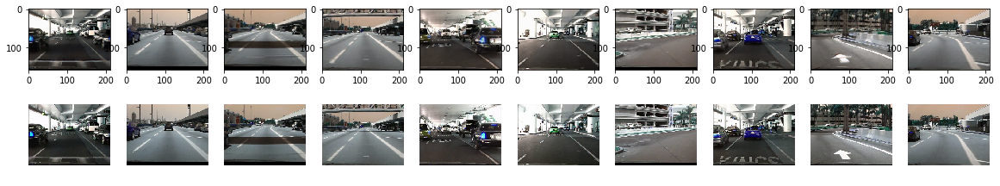

-----------------------------------
Epoch: 73
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

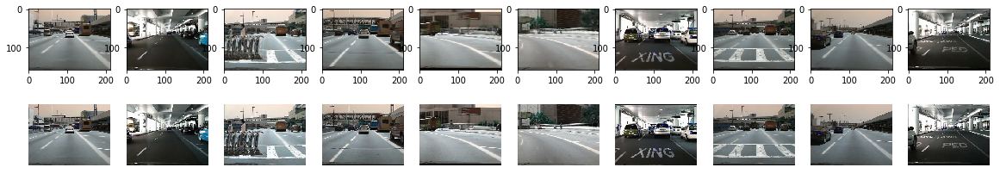

-----------------------------------
Epoch: 74
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

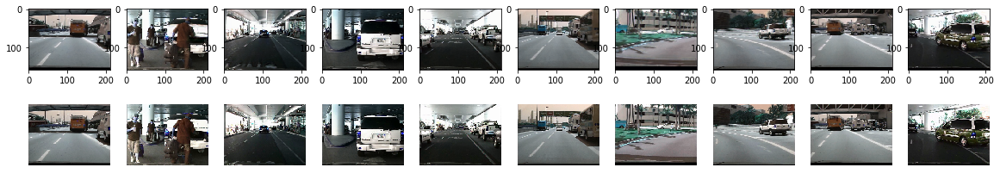

-----------------------------------
Epoch: 75
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

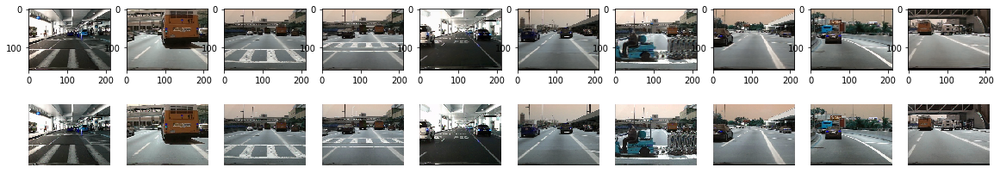

-----------------------------------
Epoch: 76
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

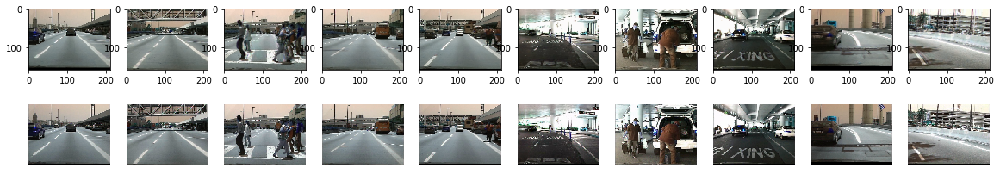

-----------------------------------
Epoch: 77
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

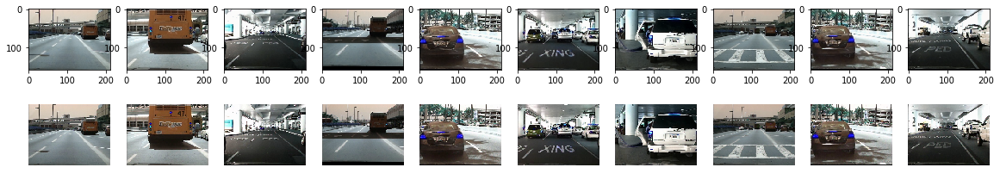

-----------------------------------
Epoch: 78
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

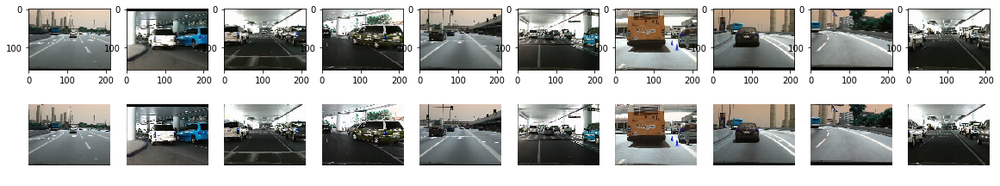

-----------------------------------
Epoch: 79
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

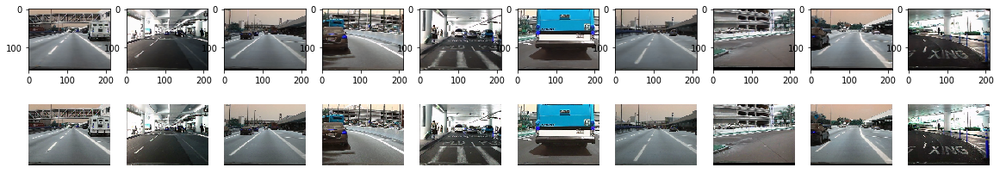

-----------------------------------
Epoch: 80
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

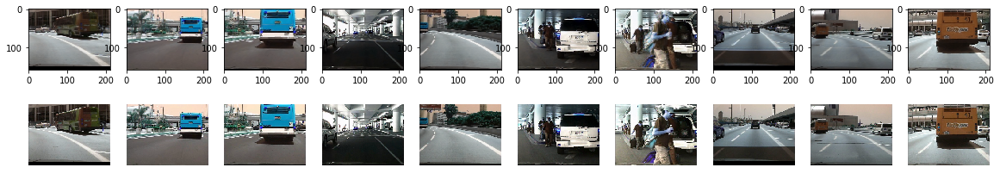

-----------------------------------
Epoch: 81
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

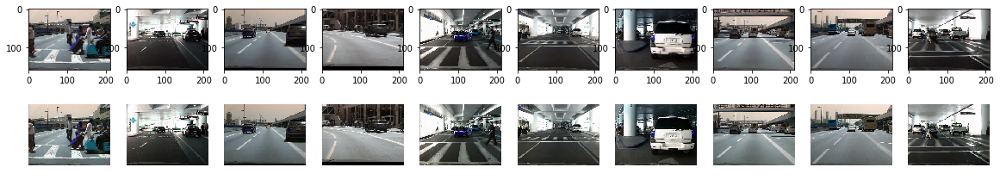

-----------------------------------
Epoch: 82
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

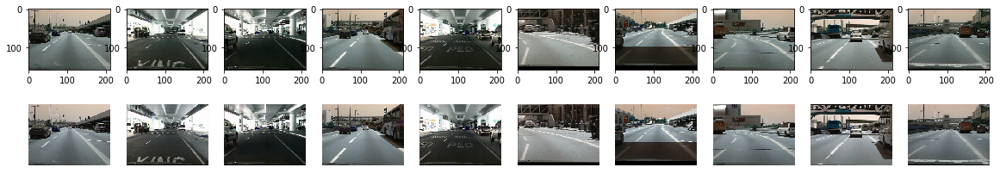

-----------------------------------
Epoch: 83
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

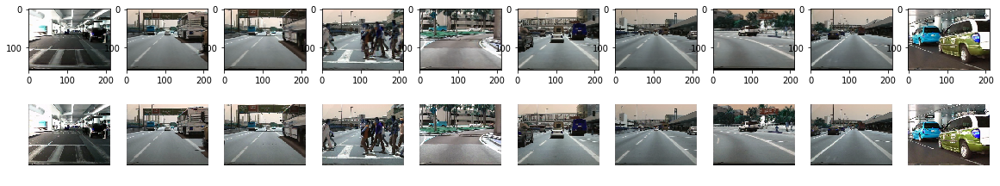

-----------------------------------
Epoch: 84
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

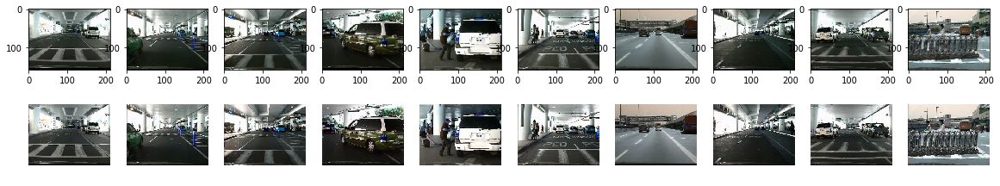

-----------------------------------
Epoch: 85
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0030


<Figure size 432x288 with 0 Axes>

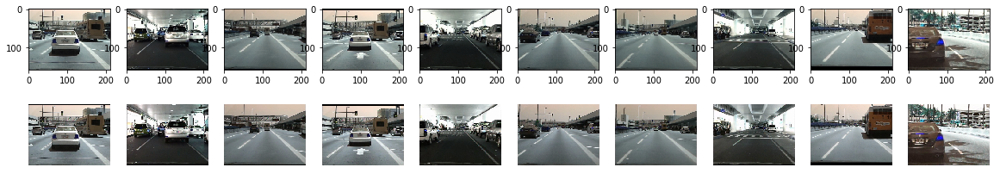

-----------------------------------
Epoch: 86
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

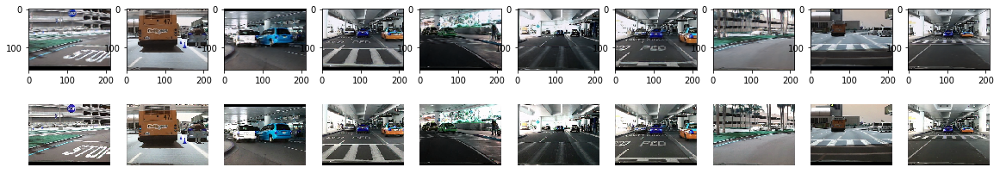

-----------------------------------
Epoch: 87
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

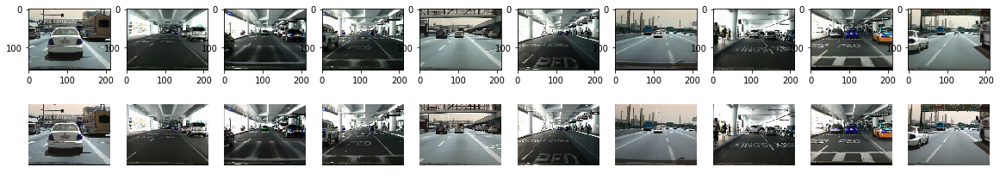

-----------------------------------
Epoch: 88
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

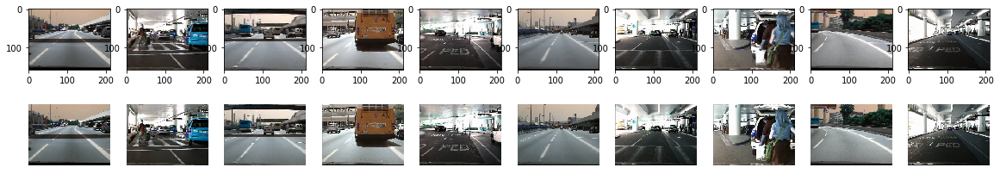

-----------------------------------
Epoch: 89
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

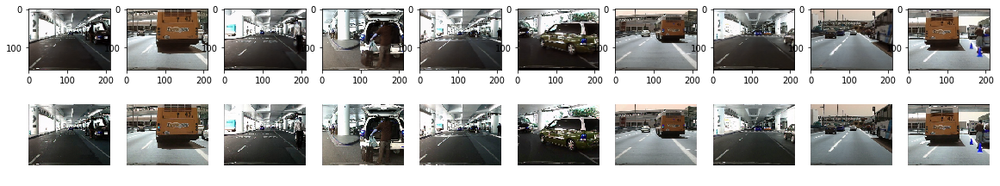

-----------------------------------
Epoch: 90
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

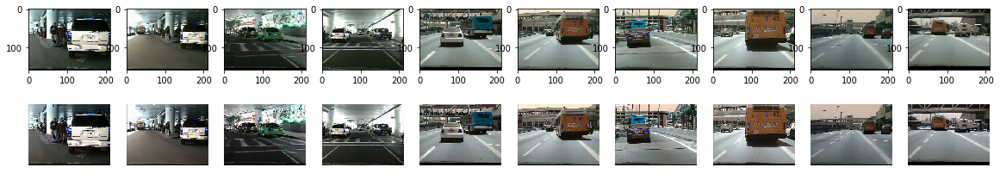

-----------------------------------
Epoch: 91
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

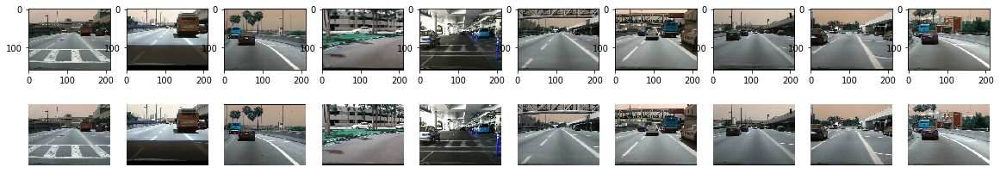

-----------------------------------
Epoch: 92
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

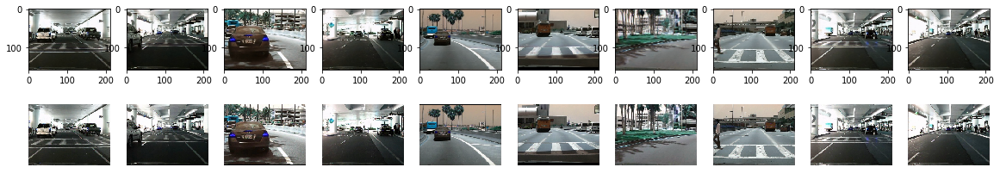

-----------------------------------
Epoch: 93
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

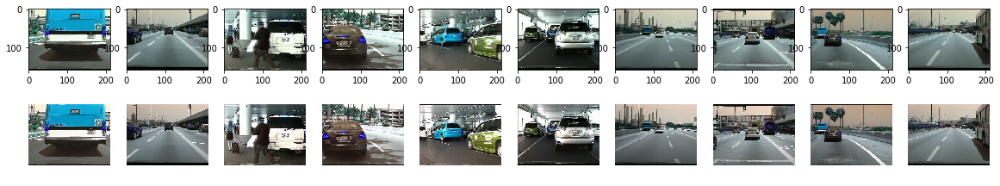

-----------------------------------
Epoch: 94
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

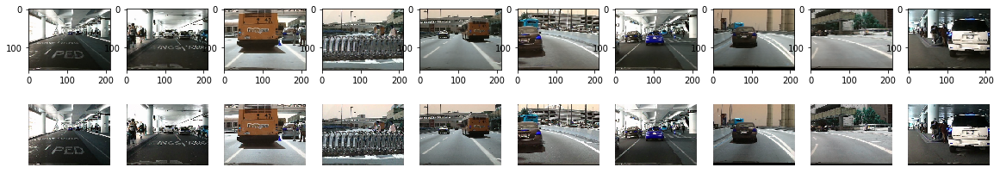

-----------------------------------
Epoch: 95
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

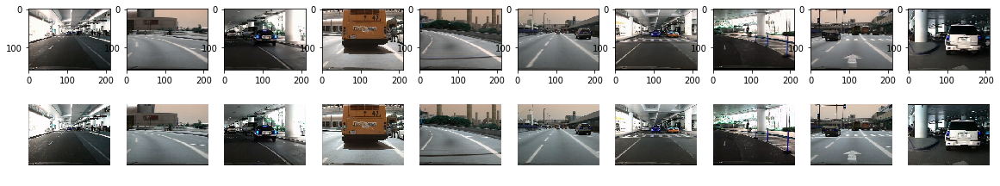

-----------------------------------
Epoch: 96
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

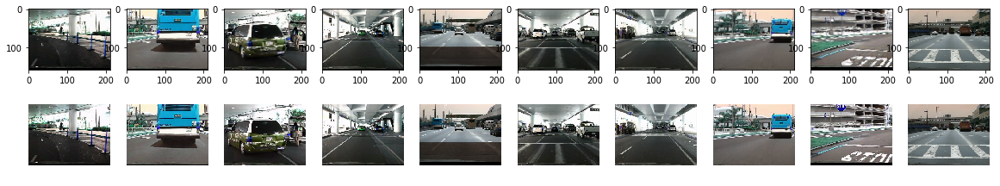

-----------------------------------
Epoch: 97
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

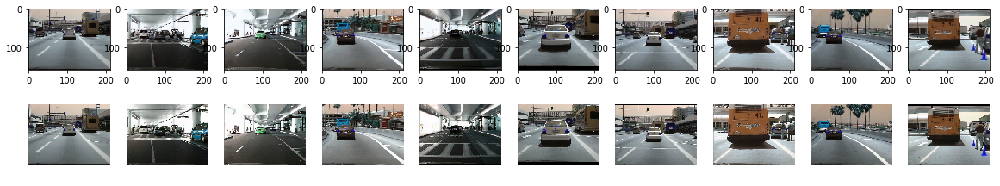

-----------------------------------
Epoch: 98
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

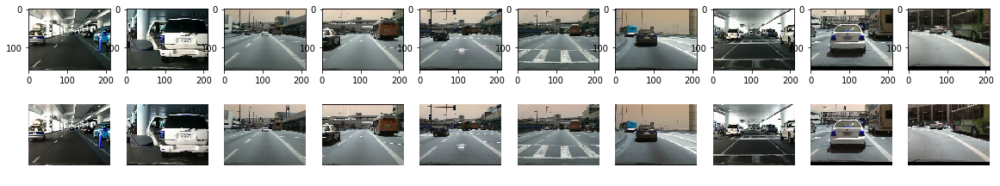

-----------------------------------
Epoch: 99
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

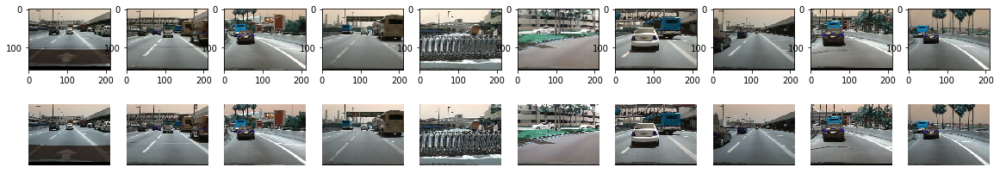

-----------------------------------
Epoch: 100
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

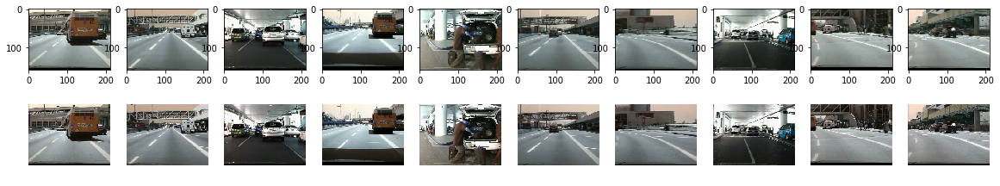

-----------------------------------
Epoch: 101
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

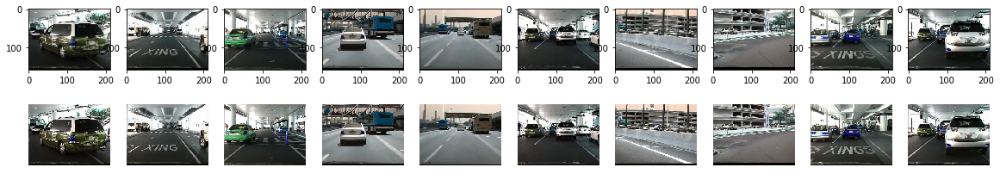

-----------------------------------
Epoch: 102
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

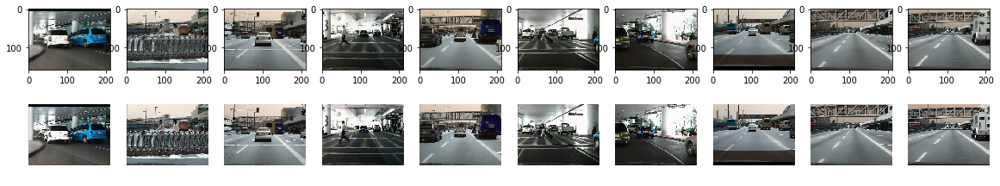

-----------------------------------
Epoch: 103
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

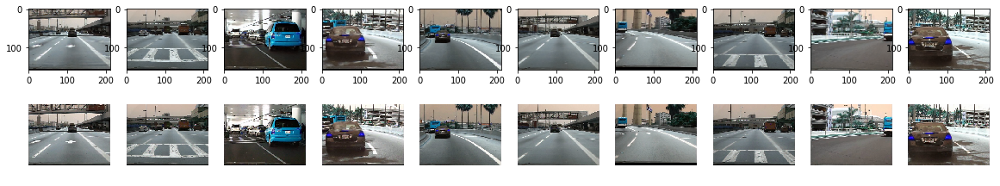

-----------------------------------
Epoch: 104
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

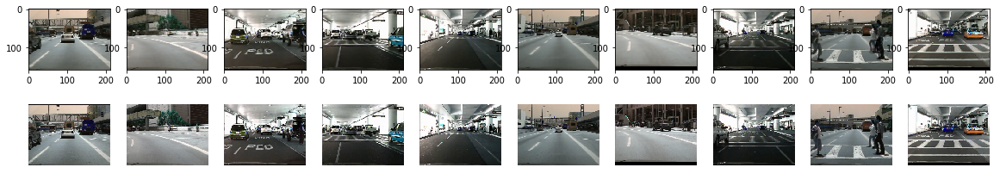

-----------------------------------
Epoch: 105
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

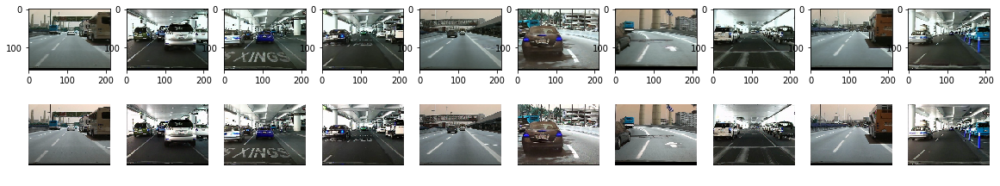

-----------------------------------
Epoch: 106
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

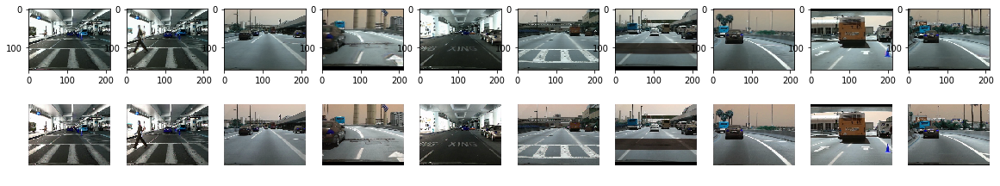

-----------------------------------
Epoch: 107
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

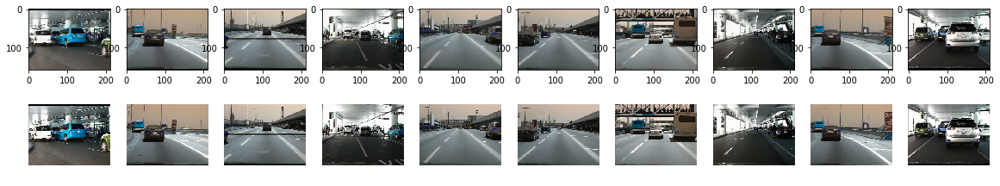

-----------------------------------
Epoch: 108
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0029


<Figure size 432x288 with 0 Axes>

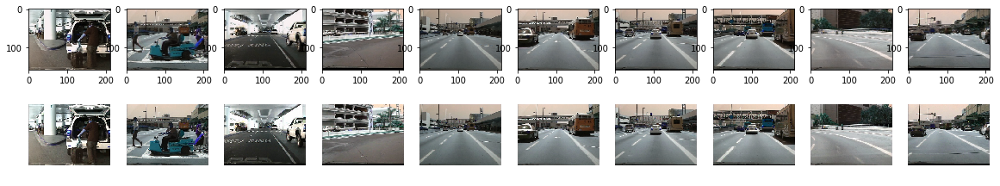

-----------------------------------
Epoch: 109
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

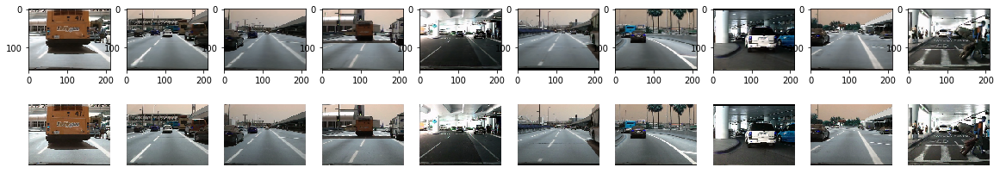

-----------------------------------
Epoch: 110
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

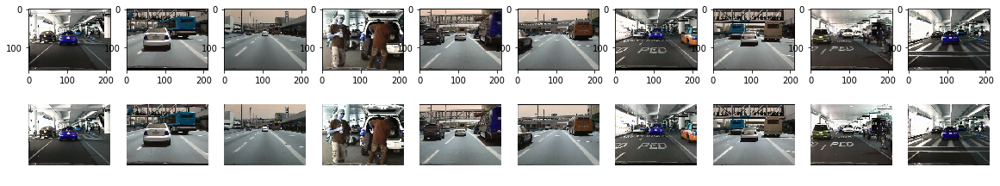

-----------------------------------
Epoch: 111
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

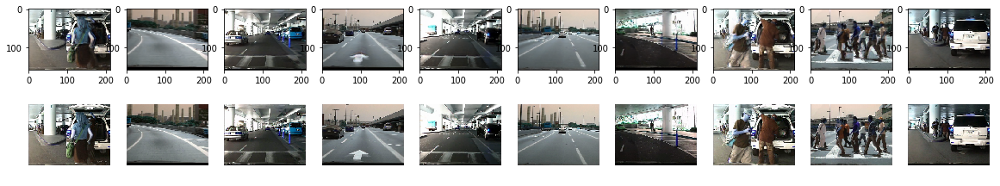

-----------------------------------
Epoch: 112
Epoch 1/1
1228/1228 [==============================] - 94s 76ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

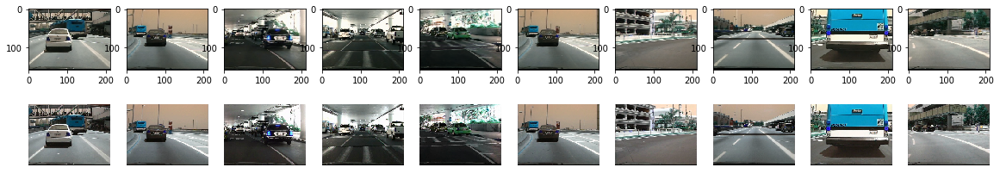

-----------------------------------
Epoch: 113
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

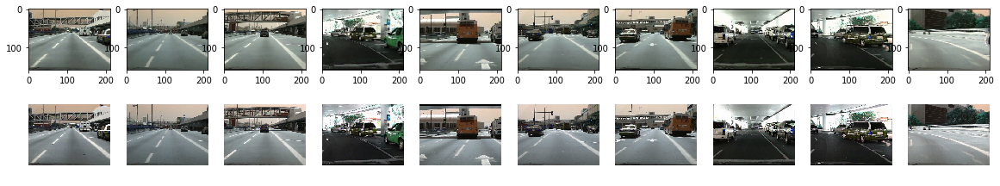

-----------------------------------
Epoch: 114
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

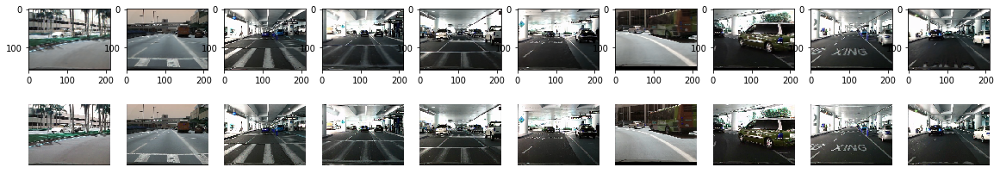

-----------------------------------
Epoch: 115
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

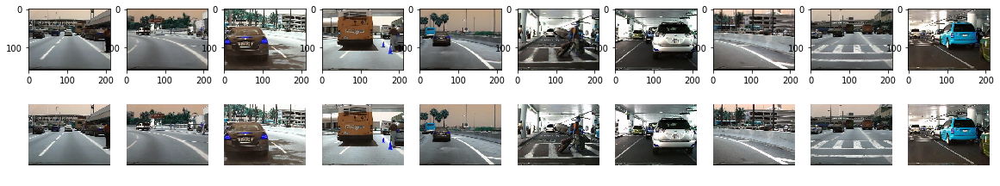

-----------------------------------
Epoch: 116
Epoch 1/1
1228/1228 [==============================] - 95s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

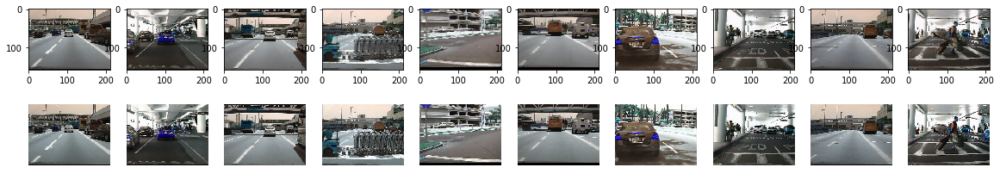

-----------------------------------
Epoch: 117
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

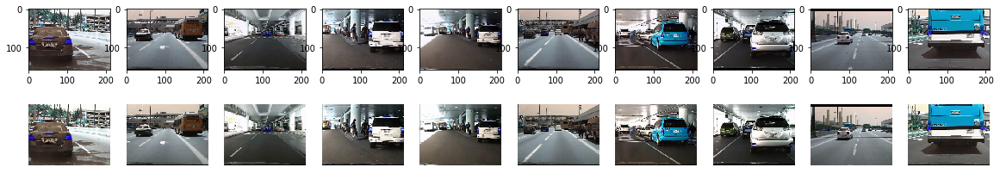

-----------------------------------
Epoch: 118
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

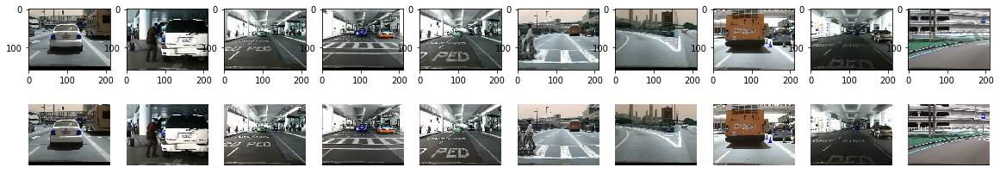

-----------------------------------
Epoch: 119
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0027


<Figure size 432x288 with 0 Axes>

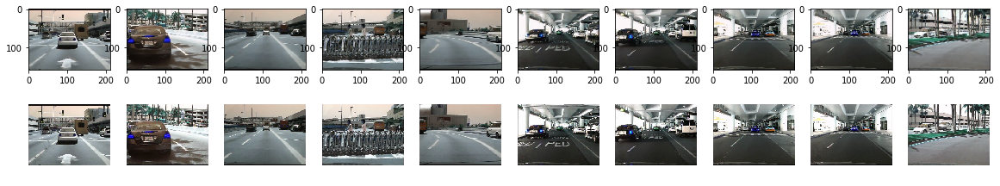

-----------------------------------
Epoch: 120
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


<Figure size 432x288 with 0 Axes>

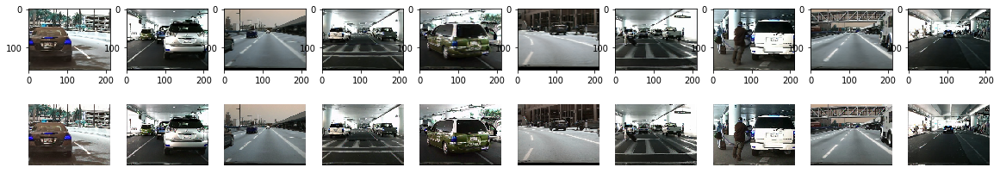

-----------------------------------
Epoch: 121
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0027


<Figure size 432x288 with 0 Axes>

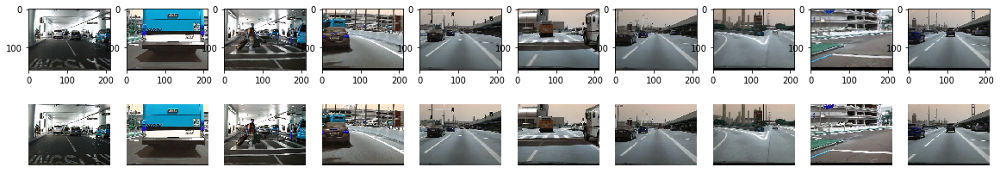

-----------------------------------
Epoch: 122
Epoch 1/1
1228/1228 [==============================] - 94s 77ms/step - loss: 0.0028


ValueError: cannot reshape array of size 800112 into shape (10,158,211,3)

<Figure size 432x288 with 0 Axes>

In [8]:
for epoch in range(1,251):
    print("Epoch:",epoch)
    model3.fit(input_sequence_frames, output_frames, batch_size=10, epochs = 1)
    
    inputs = input_sequence_frames[epoch*10: (epoch+1)*10]
    ground_truth = output_frames[epoch*10: (epoch+1)*10]
    predictions = model3.predict(inputs)
    predictions = predictions.reshape(10, 158, 211, 3)
    ground_truth = ground_truth.reshape(10, 158, 211, 3)
    plt.figure(figsize=(20, 20))
    for i in range(predictions.shape[0]):
        plt.subplot(10, 10, i+1)
        plt.imshow(predictions[i], interpolation='nearest')
        plt.subplot(10, 10, 10+i+1)
        plt.imshow(ground_truth[i], interpolation='nearest')
        plt.axis('off')
    plt.show()
    plt.tight_layout()
    if epoch % 10 == 0:
        model3.save('shuffled_caltech_ssim_epoch'+str(epoch)+'.h5')
    print('-----------------------------------')